## Direct solution: Requires a substantial number of points, and the more points, the better the results.

In [2]:
import random
import numpy as np

def count_pi(n):
    i = 0
    count = 0
    # n is the total number of points passed as input
    while i < n:
        # Generate random x and y coordinates
        x = random.random()
        y = random.random()
        # If x^2 + y^2 < 1, it's inside the circle
        if (pow(x, 2) + pow(y, 2)) <= 1:
            count += 1
        i += 1
    # The value of π is: 4 * (points inside the circle / total points)
    return 4 * (count / n)

pi = count_pi(50000000)
print(pi)

3.14145536


## Dynamic Simulation of the Monte Carlo Solving Process

Enter the number of animation frames you want (recommended between 100 and 200): 150
Enter the number of random points to be processed in parallel for a single image (recommended between 600 and 2000): 800
The value of pi obtained using the Monte Carlo method is: 3.137


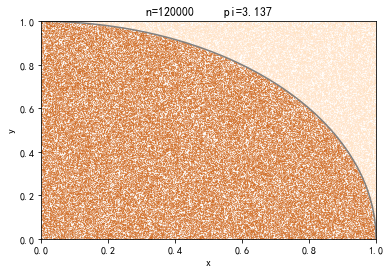

In [3]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
import random
import numpy as np
import numpy as np
np.seterr(divide='ignore', invalid='ignore')
plt.rcParams['font.sans-serif'] = ['SimHei']
plt.rcParams['axes.unicode_minus'] = False

n = 0                # Loop counter
count = 0            # Count of points inside the circle
x_yes = np.array(0)  # Points inside the circle
y_yes = np.array(0)
x_no = np.array(0)   # Points outside the circle
y_no = np.array(0)
fig = plt.figure()
answer = np.array(0) # Record of the iteration process
title_str = 'n =   ' + str(n) + ' pi = ' + str(answer)  # Image title
frames_n = input("Enter the number of animation frames you want (recommended between 100 and 200): ")
frames_n = int(frames_n)
maxn = input("Enter the number of random points to be processed in parallel for a single image (recommended between 600 and 2000): ")
maxn = int(maxn)
flag = 0             # Total number of randomly generated points recorded

## Parameters for drawing the circle ##
a = np.arange(0, 1, 0.00001)
b = np.sqrt(np.power(1, 2) - np.power(a, 2))

def update(frames):
    global count, x_yes, y_yes, x_no, y_no, n, a, b, title_count, title_str, answer, flag  # Define global variables
    plt.cla()     # Clear the current figure
    plt.ylim(0, 1)
    plt.xlim(0, 1)
    plt.xlabel('x')
    plt.ylabel('y')
    for i in range(0, maxn):
        x_new = random.random()  # Generate random x, y coordinates
        y_new = random.random()
        if (pow(x_new, 2) + pow(y_new, 2)) < 1:  # If x^2 + y^2 < 1, it's inside the circle
            count += 1
            x_yes = np.append(x_yes, x_new)
            y_yes = np.append(y_yes, y_new)
        else:
            x_no = np.append(x_no, x_new)
            y_no = np.append(y_no, y_new)
        flag += 1
        answer = np.append(answer, round(4 * (count / (flag)), 3))  # Current value of pi
        
    title_str = 'n=' + str(maxn * n) + '     pi=' + str(answer[maxn * n])  # Update title information
    plt.title(title_str)
    plt.plot(a, b, color='grey', linestyle='-')                    # Draw the circle
    plt.scatter(x_no, y_no, s=0.1, c='bisque', marker='.')      # Draw points outside the circle
    plt.scatter(x_yes, y_yes, s=0.1, c='chocolate', marker='.')  # Draw points inside the circle
    n += 1

ani = FuncAnimation(fig, update, frames=np.arange(0, frames_n), interval=0.1)
ani.save("./test-1.gif", writer='pillow')  # Save the animated gif

answer_final = round(4 * (count / flag), 3)  # Final result
print("The value of pi obtained using the Monte Carlo method is: " + str(answer_final))
plt.show()

## Visualization of the Iterative Convergence Process

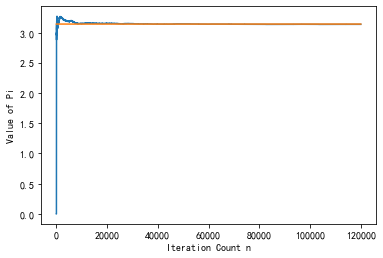

In [4]:
plt.figure()

plt.xlabel('Iteration Count n')
plt.ylabel('Value of Pi')
plt.title
plt.plot(np.arange(0, maxn * frames_n), answer[0:maxn * frames_n])
plt.plot(np.arange(0, maxn * frames_n), 3.14159 * np.ones(maxn * frames_n))
plt.show()

## It can be observed that as the number of iterations increases, the result gets closer to pi. However, Monte Carlo is inherently a statistical estimation method, and using it for precise calculation of pi is inefficient.

In [4]:
%load_ext pycodestyle_magic

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from scipy.optimize import curve_fit
from IPython.display import HTML
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 100000000

def gauss(x_vals, mu, sigma, A):
    '''
    Function:
        Used for scipy's curve_fit function to fit input data 
        into a Gaussian curve.
    Parameters:
        x_vals: Array of independent variable values.
        μ: Mean.
        sigma: Standard deviation.
        A: Amplitude.
    Returns:
        An array with the same shape as x_vals containing variable values 
        in the shape of a Gaussian curve.
    '''
    return A*np.exp(-0.5*(((x_vals - mu) / sigma)**2))/sigma/np.sqrt(2*np.pi)

L = 1 
D = 0.001
N = 100  # Number of grid points along a single axis
dt = 0.01
dx = L/N  # Define differentiation
tmax = 100
steps = int(tmax//dt)+1

# Prepare for fitting middle-plane data for t between 0.01 and 10, 
# and store the standard deviation for each fit.
# For later plotting, we need samples evenly spaced on sqrt(t), 
# but to make the plotting steps compatible with the main computation,
# we square the interval values:
plotsteps = np.linspace(np.sqrt(0.01), np.sqrt(10), 30)**2
plotsteps /= dt
plotsteps = plotsteps.astype(int)
sigmas = np.zeros(len(plotsteps))
x = np.linspace(0, L, N)
guesses = np.array([0.5, 0.2, 0.008])

# For adding sigma values to sigmas:
sig_count = 0

# Initial condition:
C = np.zeros((N, N))
C[N//2, N//2] = 10

# Total diffusion coefficient:
k = dt*D/dx/dx

# 2D array for updating calculations:
Cp = np.zeros((N, N))

# Set up animation requirements, establish an iterable
# over which we store animation frames and grid sums:
fig = plt.figure()
ims = []
animate = np.arange(0, tmax, 0.1)
animate /= dt
animate = animate.astype(int)
sums = np.zeros(len(animate))

# For adding sum values to sums:
sum_count = 0

for n in range(steps):
    # Calculate points, except the boundaries:
    Cp[1:-1, 1:-1] = (C[1:-1, 1:-1] + k *
                      ((C[1:-1, 2:] + C[1:-1, :-2] - 2*C[1:-1, 1:-1]) +
                       (C[2:, 1:-1] + C[:-2, 1:-1] - 2*C[1:-1, 1:-1])))
    # Calculate the boundaries:
    Cp[:, 0] = Cp[:, 1]
    Cp[:, -1] = Cp[:, -2]
    Cp[0, :] = Cp[1, :]
    Cp[-1, :] = Cp[-2, :]

    # Reset C as Cp:
    C, Cp = Cp, C

    # Accumulate standard deviations in 'sigmas':
    if n in plotsteps:
        Cy_mid = C[:, N//2]
        # Fit the data:
        fit_params, fit_cov = curve_fit(gauss, x, Cy_mid, p0=guesses)
        sigmas[sig_count] = fit_params[1]
        sig_count += 1

    # Accumulate animation frames and grid sums:
    if n in animate:
        ims.append((plt.pcolormesh(C.copy(), vmin=0), ))
        sums[sum_count] = np.sum(C)
        sum_count += 1

# Display animation:
iman = animation.ArtistAnimation(fig, ims, interval=15, repeat=False)
plt.close()
HTML(iman.to_jshtml())